# **PRUEBAS PARA DETERMINAR EL ALINEAMIENTO**

In [ ]:
def findRecPath(recording_name = "20190808_171636", SPLITS = ['test'], path = '/mnt/gpid08/datasets/How2Sign/How2Sign_RGB-D/videos/'):
    """
    Returns the path where the recording is located.
    """
    fpath = ""
    string_start_array = ["_Color", "_Depth"]
    found_path = 0
    for partition in SPLITS:    
        for data_folder in os.listdir(path + partition + "/"):
            if found_path:
                break
            for date_folder in os.listdir(path + partition + "/" + data_folder + "/"):
                if found_path:
                    break
                for recording in os.listdir(path + partition + "/" + data_folder + "/" + date_folder + "/"):
                    if found_path:
                        break
                    if recording == recording_name:
                        for video in os.listdir(path + partition + "/" + data_folder + "/" + date_folder + "/" + recording + "/"):
                            if string_start_array[0] in video:
                                fpath = path + partition + "/" + data_folder + "/" + date_folder + "/" + recording + "/" + video
                                print(f'{fpath}', flush = True)
                                found_path = 1
                                
    return fpath

20190530_175020
/mnt/gpid08/datasets/How2Sign/How2Sign_RGB-D/videos/test/Data_2/05-30-2019/20190530_175020/20190530_175020_Color_video.mp4


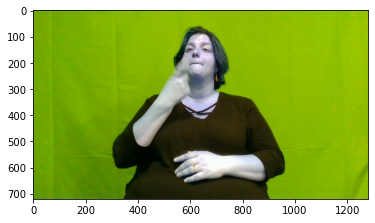

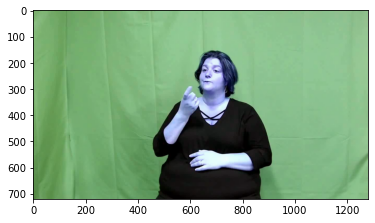

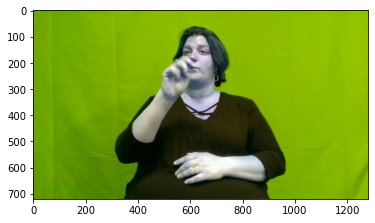

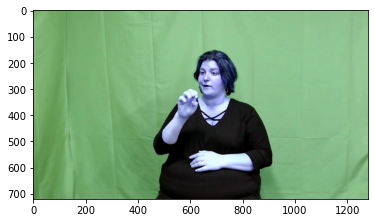

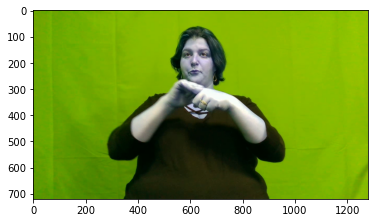

...

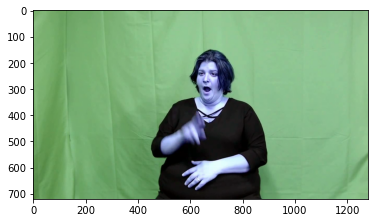

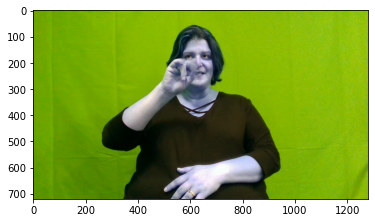

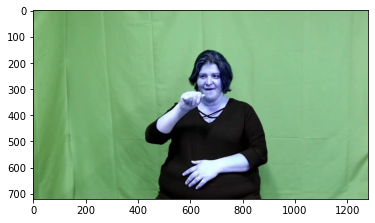

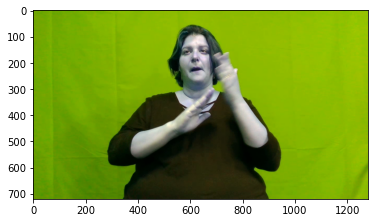

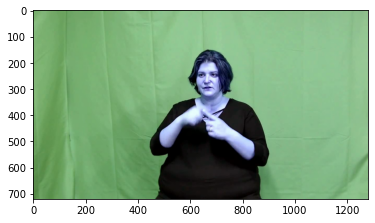

KeyboardInterrupt: 

In [ ]:
import cv2
import numpy as np
import glob
import os
from matplotlib import pyplot as plt

#video and recording path
vid_path = "/mnt/gpid08/datasets/How2Sign/How2Sign/video_level/test/video_50frames/rgb_front/G3k86AVFwVs-5-rgb_front.mp4"
rec_path = findRecPath("20190530_175020")


cap = cv2.VideoCapture(rec_path)
cap2 = cv2.VideoCapture(vid_path)

#Introduce the alignment parameters
start = 30
frame_rate_rec = 30
frame_rate_vid = 50

offset_rec = 17
offset_vid = 0

cnt_rec= frame_rate_rec - offset_rec
cnt_vid = frame_rate_vid - offset_vid

rec_img =[]
vid_img = []

#storing the sequence of frames (recording)
while True:
    ret, frame = cap.read()
    if ret == False:
        break
    if cnt_rec == frame_rate_rec:
        rec_img.append(frame)
        cnt_rec = 1
    else:
        cnt_rec+=1
        
#storing the sequence of frames (video)
while True:
    ret2, frame2 = cap2.read()
    if ret2 == False:
        break
    if cnt_vid == frame_rate_vid:
        vid_img.append(frame2)
        cnt_vid = 1
    else:
        cnt_vid+=1

#representing both sequences from the start point        
for i in range(len(rec_img)):
    if i >= start:
        plt.imshow(rec_img[i])
        plt.show()
        plt.imshow(vid_img[i-start])
        plt.show()


    
